In [2]:
import pandas as pd 
import datetime
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import plotly.express as px
plt.style.use('ggplot')

## Data Loading

In [3]:
df = pd.read_csv(
    'ChargePoint Data CY20Q4.csv', dtype={'Station Name': str}, 
    parse_dates=['Start Date', 'Total Duration (hh:mm:ss)'], infer_datetime_format=True, low_memory=False)

# Make a unique id for each row
df['Id'] = df.index
# Drop columns that are not needed
df.drop(
    ['User ID', 'County', 'City', 'Postal Code', 'Driver Postal Code',
    'State/Province', 'Fee', 'Currency', 'EVSE ID', 'Transaction Date (Pacific Time)',
    'GHG Savings (kg)', 'Gasoline Savings (gallons)', 'Org Name',
    'Address 1', 'System S/N', 'Plug In Event Id', 'Ended By',
    'End Time Zone', 'Start Time Zone', 'Country', 'Model Number'
    ], axis=1, inplace=True)

df.isna().sum()

Station Name                 0
MAC Address                  0
Start Date                   0
End Date                     0
Total Duration (hh:mm:ss)    0
Charging Time (hh:mm:ss)     0
Energy (kWh)                 0
Port Type                    9
Port Number                  0
Plug Type                    0
Latitude                     0
Longitude                    0
Id                           0
dtype: int64

In [4]:
df['Total Duration (min)'] = pd.to_timedelta(df['Total Duration (hh:mm:ss)']).dt.total_seconds()/60
df['Charging Time (min)'] = pd.to_timedelta(df['Charging Time (hh:mm:ss)']).dt.total_seconds()/60

In [6]:
# There's Excel formatting in the End Data column, so we need to convert from Excel serial to datetime
# https://stackoverflow.com/questions/6706231/fetching-datetime-from-float-in-python
def convert_to_datetime(serial):
    try:
        return pd.to_datetime(serial)
    except:
        seconds = (float(serial) - 25569) * 86400.0
        return datetime.datetime.utcfromtimestamp(seconds)

df['End Date'] = df['End Date'].apply(convert_to_datetime)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259415 entries, 0 to 259414
Data columns (total 15 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Station Name               259415 non-null  object        
 1   MAC Address                259415 non-null  object        
 2   Start Date                 259415 non-null  datetime64[ns]
 3   End Date                   259415 non-null  datetime64[ns]
 4   Total Duration (hh:mm:ss)  259415 non-null  object        
 5   Charging Time (hh:mm:ss)   259415 non-null  object        
 6   Energy (kWh)               259415 non-null  float64       
 7   Port Type                  259406 non-null  object        
 8   Port Number                259415 non-null  int64         
 9   Plug Type                  259415 non-null  object        
 10  Latitude                   259415 non-null  float64       
 11  Longitude                  259415 non-null  float64 

### Create clusters based on Station Names

In [7]:
print("Number of unique stations:", df['Station Name'].nunique())
df['Cluster'] = df['Station Name'].str.split(' ').str[4]
print(df['Cluster'].value_counts())

Number of unique stations: 47
BRYANT       47100
HIGH         39901
HAMILTON     38609
WEBSTER      37585
CAMBRIDGE    32879
MPL          28326
RINCONADA    18264
TED          16712
SHERMAN         39
Name: Cluster, dtype: int64


## Data Visualization

In [8]:
# plot the geographical distribution of the charging stations
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

[]

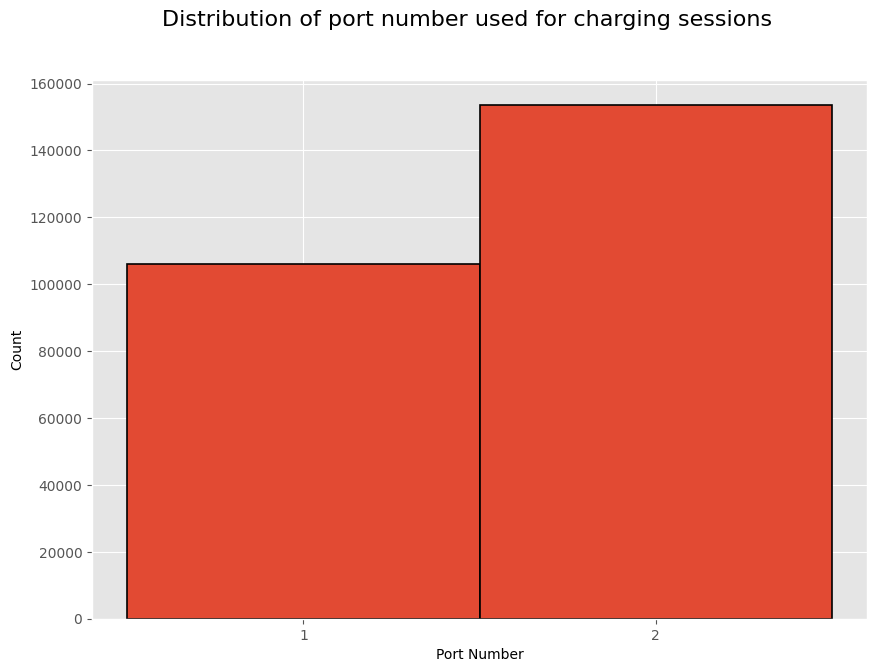

In [55]:
bins = np.arange(1, df['Port Number'].max() + 1.5) - 0.5
# then you plot away
fig, ax = plt.subplots(figsize=(10, 7))
fig.suptitle('Distribution of port number used for charging sessions', fontsize=16)

_ = ax.hist(df['Port Number'], bins, edgecolor='k', linewidth=1.2)
ax.set_xticks(bins + 0.5)
ax.set_xlabel('Port Number')
ax.set_ylabel('Count')
plt.plot()

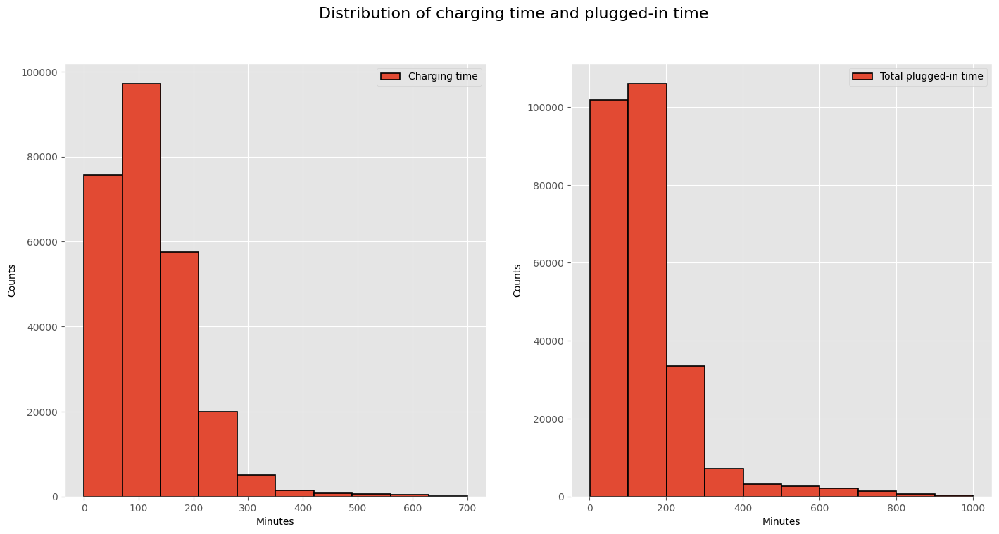

In [56]:
# Histogram of charging and total plugged in time
fig, ax = plt.subplots(1,2, figsize=(17, 8))
fig.suptitle('Distribution of charging time and plugged-in time', fontsize=16)
# Filter out extreme values
df_his = df[(df['Charging Time (min)'] < 700) & (df['Total Duration (min)'] < 1000)]

ax[0].hist(df_his['Charging Time (min)'], label="Charging time", edgecolor='k', linewidth=1.2)
ax[1].hist(df_his['Total Duration (min)'], label="Total plugged-in time", edgecolor='k', linewidth=1.2)

for i in range(len(ax)):
    ax[i].set_xlabel('Minutes')
    ax[i].set_ylabel('Counts')
    ax[i].legend()

plt.show()

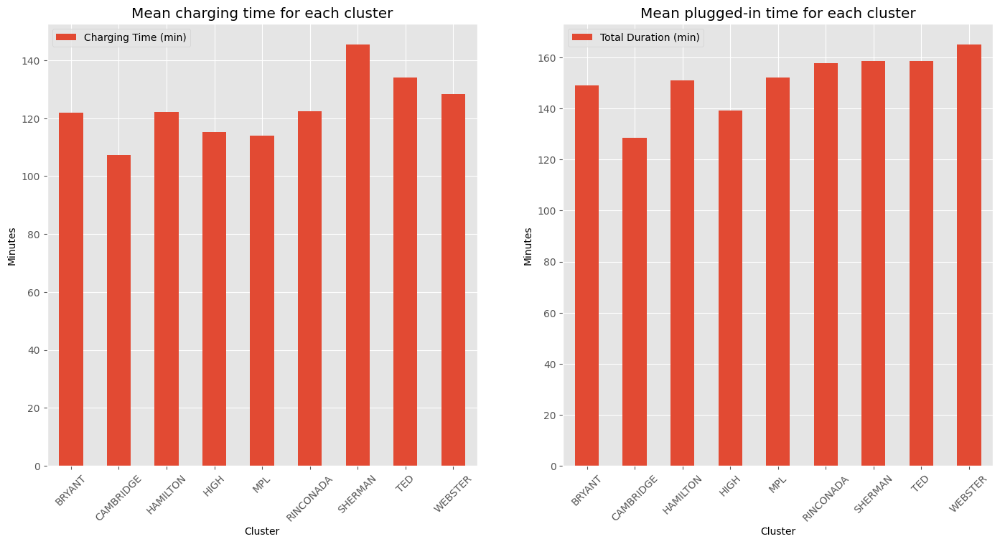

In [52]:
fig, ax = plt.subplots(1,2, figsize=(17, 8))
df.groupby(['Cluster'])['Charging Time (min)'].mean().plot(ax=ax[0], kind='bar',  title='Mean charging time for each cluster', rot=45)
df.groupby(['Cluster'])['Total Duration (min)'].mean().plot(ax=ax[1], kind='bar', title='Mean plugged-in time for each cluster', rot=45)
for i in range(len(ax)):
    ax[i].set_ylabel('Minutes')
    ax[i].legend()

plt.show()

## Create count-process 

In [10]:
# Create counts for number of sessions in each interval. 
# The `Period` defines when the period starts and runs until the next period in the dataframe.
INTERVAL_LENGTH = 30 # minutes
df_combined = pd.DataFrame()
for cluster in df['Cluster'].unique():
    # Collect each period that the charging session covers in the 'Period' column. This column will contain a list of datetimes :)
    df.loc[df.Cluster == cluster, 'Period'] = np.array([pd.date_range(s, e, freq='T') for s, e in zip(df[df.Cluster == cluster]['Start Date'], df[df.Cluster == cluster]['End Date'])], dtype=object)
    # The the count of 
    res = df[df.Cluster == cluster].explode('Period').groupby(pd.Grouper(key='Period', freq=f'{INTERVAL_LENGTH}T'))['Id'].nunique()
    # rename energy to sessions
    res.rename('Sessions', inplace=True)
    data = res.to_frame()
    data = data.reset_index()
    data.Period = pd.to_datetime(data.Period)
    data["Cluster"] = cluster
    df_combined = pd.concat([df_combined, data])

In [11]:
df_combined[df_combined.Cluster == 'BRYANT'].head()

,Period,Sessions,Cluster
0,2011-10-10 15:00:00,1,BRYANT
1,2011-10-10 15:30:00,0,BRYANT
2,2011-10-10 16:00:00,0,BRYANT
3,2011-10-10 16:30:00,0,BRYANT
4,2011-10-10 17:00:00,0,BRYANT


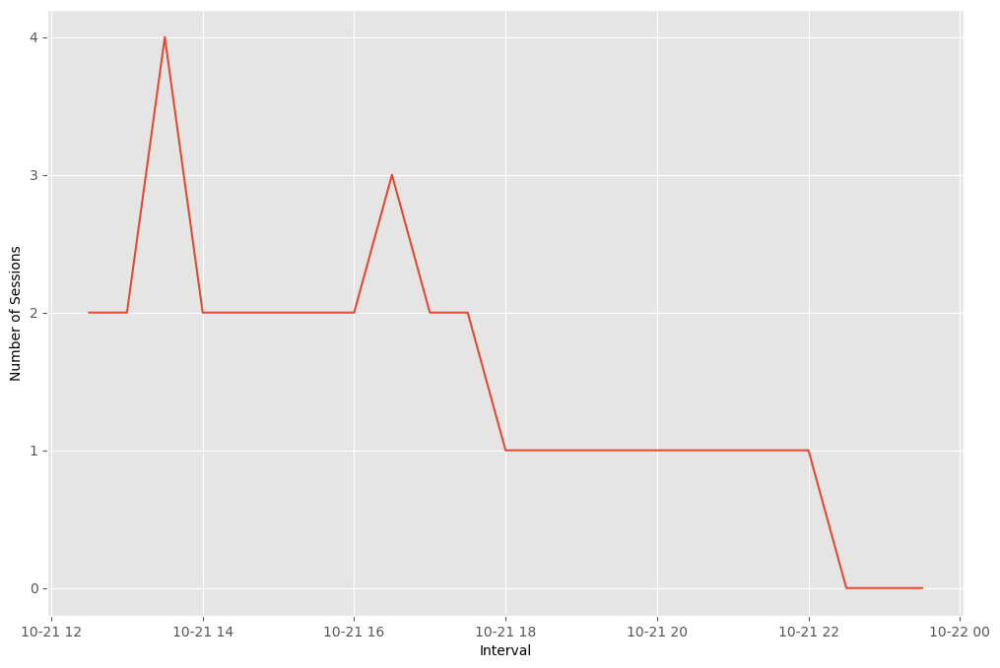

In [58]:
fig, ax = plt.subplots(figsize=(12, 8))
CLUSTER = 'BRYANT'
START = '2011-10-21 12:00'
END = '2011-10-22'

boi = df_combined[df_combined.Cluster == CLUSTER].loc[(df_combined[df_combined.Cluster == CLUSTER].Period > START) & (df_combined[df_combined.Cluster == CLUSTER].Period < END)]
ax.plot(boi.Period, boi.Sessions)
# Make y-axis integral
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.set_xlabel('Interval')
ax.set_ylabel('Number of Sessions')
plt.show()

In [13]:
df[df.Cluster == CLUSTER].loc[(df[df.Cluster == CLUSTER]['End Date'] > '2011-10-21 12:30') & (df[df.Cluster == CLUSTER]['Start Date'] < '2011-10-22 12:00')]

,Station Name,MAC Address,Start Date,End Date,Total Duration (hh:mm:ss),Charging Time (hh:mm:ss),Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Id,Total Duration (min),Charging Time (min),Cluster,Period
500,PALO ALTO CA / BRYANT #2,000D6F0000A2108E,2011-10-21 09:16:00,2011-10-21 13:45:00,4:29:09,1:42:24,4.950762,Level 2,2,J1772,37.446373,-122.162331,500,269.150000,102.400000,BRYANT,"DatetimeIndex(['2011-10-21 09:16:00', '2011-10..."
503,PALO ALTO CA / BRYANT #1,000D6F0000A20D9E,2011-10-21 12:41:00,2011-10-21 13:45:00,1:03:51,1:03:44,5.135938,Level 2,2,J1772,37.446373,-122.162331,503,63.850000,63.733333,BRYANT,"DatetimeIndex(['2011-10-21 12:41:00', '2011-10..."
504,PALO ALTO CA / BRYANT #1,000D6F0000A20D9E,2011-10-21 13:46:00,2011-10-21 16:58:00,3:11:36,1:49:13,6.453933,Level 2,2,J1772,37.446373,-122.162331,504,191.600000,109.216667,BRYANT,"DatetimeIndex(['2011-10-21 13:46:00', '2011-10..."
505,PALO ALTO CA / BRYANT #2,000D6F0000A2108E,2011-10-21 13:55:00,2011-10-21 17:43:00,3:47:45,3:47:37,13.922402,Level 2,2,J1772,37.446373,-122.162331,505,227.750000,227.616667,BRYANT,"DatetimeIndex(['2011-10-21 13:55:00', '2011-10..."
508,PALO ALTO CA / BRYANT #1,000D6F0000A20D9E,2011-10-21 16:59:00,2011-10-21 22:20:00,5:20:58,3:57:43,14.575480,Level 2,2,J1772,37.446373,-122.162331,508,320.966667,237.716667,BRYANT,"DatetimeIndex(['2011-10-21 16:59:00', '2011-10..."


In [14]:
df[df.Cluster == 'HAMILTON'].sort_values(by='Start Date', ascending=False).head(10)

,Station Name,MAC Address,Start Date,End Date,Total Duration (hh:mm:ss),Charging Time (hh:mm:ss),Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Id,Total Duration (min),Charging Time (min),Cluster,Period
257337,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-04 04:54:00,2020-11-04 06:50:00,1:56:47,1:53:10,5.221,Level 2,2,J1772,37.444706,-122.160324,257337,116.783333,113.166667,HAMILTON,"DatetimeIndex(['2020-11-04 04:54:00', '2020-11..."
257335,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 18:03:00,2020-11-20 03:11:00,5:40:12,5:22:23,16.590,Level 2,2,J1772,37.444489,-122.160370,257335,340.200000,322.383333,HAMILTON,"DatetimeIndex(['2020-11-03 18:03:00', '2020-11..."
257332,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 17:29:00,2020-11-03 19:07:00,1:38:20,1:38:02,5.562,Level 2,1,J1772,37.444706,-122.160324,257332,98.333333,98.033333,HAMILTON,"DatetimeIndex(['2020-11-03 17:29:00', '2020-11..."
257330,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 16:45:00,2020-11-03 21:43:00,4:58:02,4:57:51,15.403,Level 2,2,J1772,37.444706,-122.160324,257330,298.033333,297.850000,HAMILTON,"DatetimeIndex(['2020-11-03 16:45:00', '2020-11..."
257322,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 13:59:00,2020-11-03 14:58:00,0:58:36,0:58:30,5.508,Level 2,2,J1772,37.444489,-122.160370,257322,58.600000,58.500000,HAMILTON,"DatetimeIndex(['2020-11-03 13:59:00', '2020-11..."
257297,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 08:48:00,2020-11-03 11:40:00,2:51:22,2:11:55,6.545,Level 2,2,J1772,37.444489,-122.160370,257297,171.366667,131.916667,HAMILTON,"DatetimeIndex(['2020-11-03 08:48:00', '2020-11..."
257294,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 07:42:00,2020-11-03 16:17:00,8:34:51,8:34:34,47.757,Level 2,1,J1772,37.444706,-122.160324,257294,514.850000,514.566667,HAMILTON,"DatetimeIndex(['2020-11-03 07:42:00', '2020-11..."
257290,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 05:00:00,2020-11-03 07:02:00,2:02:42,1:47:46,4.948,Level 2,1,J1772,37.444706,-122.160324,257290,122.700000,107.766667,HAMILTON,"DatetimeIndex(['2020-11-03 05:00:00', '2020-11..."
257286,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-02 16:14:00,2020-11-02 21:58:00,5:43:50,5:43:30,32.128,Level 2,1,J1772,37.444706,-122.160324,257286,343.833333,343.500000,HAMILTON,"DatetimeIndex(['2020-11-02 16:14:00', '2020-11..."
257262,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-02 04:42:00,2020-11-02 06:44:00,2:01:32,1:46:28,4.873,Level 2,1,J1772,37.444706,-122.160324,257262,121.533333,106.466667,HAMILTON,"DatetimeIndex(['2020-11-02 04:42:00', '2020-11..."


In [15]:
pd.to_timedelta(datetime.datetime.strptime('1:56:47', '%H:%M:%S').total_seconds().astype(int))

AttributeError: 'datetime.datetime' object has no attribute 'total_seconds'

In [ ]:
pd.to_datetime(df['Total Duration (hh:mm:ss)'].loc[:5]).dt.hour * 60 + pd.to_datetime(df['Total Duration (hh:mm:ss)'].loc[:5]).dt.minute + pd.to_datetime(df['Total Duration (hh:mm:ss)'].loc[:5]).dt.second

0    11012
1      126
2    15452
3     7404
4     4284
5    13933
Name: Total Duration (hh:mm:ss), dtype: int64

0          183.533333
1            2.100000
2          257.533333
3          123.400000
4           71.400000
             ...     
259410      35.733333
259411     223.016667
259412    1048.233333
259413     245.566667
259414      42.116667
Name: Total Duration (hh:mm:ss), Length: 259415, dtype: float64

In [ ]:
df['Total Duration (hh:mm:ss)'].loc[:5]

0    3:03:32
1    0:02:06
2    4:17:32
3    2:03:24
4    1:11:24
5    3:52:13
Name: Total Duration (hh:mm:ss), dtype: object